## YOLOv8 COCO Dataset Train and Predict w/wandb

In [2]:
%pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 595.6/595.6 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.8/61.8 MB 20.0 MB/s eta 0:00:00
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.5.4.60
    Uninstalling opencv-python-4.5.4.60:
      Successfully uninstalled opencv-python-4.5.4.60
Note: you may need to restart the kernel to use updated packages.


In [3]:
import os
import cv2
import numpy as np
import pandas as pd
from tqdm import tqdm
import shutil
from shutil import copyfile
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')
from PIL import Image

import ultralytics
from ultralytics import YOLO
ultralytics.checks()


Ultralytics YOLOv8.0.115 🚀 Python-3.7.12 torch-1.11.0 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)
Setup complete ✅ (2 CPUs, 15.6 GB RAM, 4726.0/8062.4 GB disk)


In [4]:
from kaggle_secrets import UserSecretsClient
import wandb
user_secrets = UserSecretsClient()
secret_value = user_secrets.get_secret("wandb_api_key")
wandb.login(key=secret_value)

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [5]:
import zipfile

def create_zip(source_folder, destination_zip):
    with zipfile.ZipFile(destination_zip, 'w', zipfile.ZIP_DEFLATED) as zip_ref:
        for root, dirs, files in os.walk(source_folder):
            for file in files:
                file_path = os.path.join(root, file)
                zip_ref.write(file_path, arcname=os.path.relpath(file_path, source_folder))

def extract_zip(zip_file, destination_folder):
    with zipfile.ZipFile(zip_file, 'r') as zip_ref:
        zip_ref.extractall(destination_folder)
        
source_folder = '/kaggle/input/coco128-data-for-yolov8'
destination_zip = '/kaggle/working/folder.zip'
destination_folder = '/kaggle/working/'

create_zip(source_folder, destination_zip)
extract_zip(destination_zip, destination_folder)

# Create yaml file 

In [6]:
import yaml

coco_yaml = dict(
    train ='train',
    val ='valid',
    test='test',
    nc =80,
    names =['person', 'bicycle', 'car', 'motorbike', 'aeroplane', 'bus', 
            'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 
            'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 
            'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 
            'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 
            'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 
            'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 
            'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 
            'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 
            'hot dog', 'pizza', 'donut', 'cake', 'chair', 'sofa', 'pottedplant', 
            'bed', 'diningtable', 'toilet', 'tvmonitor', 'laptop', 'mouse', 
            'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 
            'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 
            'scissors', 'teddy bear', 'hair drier', 'toothbrush']
)

with open('coco.yaml', 'w') as outfile:
    yaml.dump(coco_yaml, outfile, default_flow_style=True)
    
%cat coco.yaml

{names: [person, bicycle, car, motorbike, aeroplane, bus, train, truck, boat, traffic
      light, fire hydrant, stop sign, parking meter, bench, bird, cat, dog, horse,
    sheep, cow, elephant, bear, zebra, giraffe, backpack, umbrella, handbag, tie,
    suitcase, frisbee, skis, snowboard, sports ball, kite, baseball bat, baseball
      glove, skateboard, surfboard, tennis racket, bottle, wine glass, cup, fork,
    knife, spoon, bowl, banana, apple, sandwich, orange, broccoli, carrot, hot dog,
    pizza, donut, cake, chair, sofa, pottedplant, bed, diningtable, toilet, tvmonitor,
    laptop, mouse, remote, keyboard, cell phone, microwave, oven, toaster, sink, refrigerator,
    book, clock, vase, scissors, teddy bear, hair drier, toothbrush], nc: 80, test: test,
  train: train, val: valid}


In [7]:
names =['person', 'bicycle', 'car', 'motorbike', 'aeroplane', 'bus', 
        'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 
        'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 
        'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 
        'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 
        'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 
        'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 
        'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 
        'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 
        'hot dog', 'pizza', 'donut', 'cake', 'chair', 'sofa', 'pottedplant', 
        'bed', 'diningtable', 'toilet', 'tvmonitor', 'laptop', 'mouse', 
        'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 
        'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 
        'scissors', 'teddy bear', 'hair drier', 'toothbrush']
N=list(range(len(names)))
class_map=dict(zip(N,names))

# Train

In [8]:
model = YOLO("yolov8n.pt") 
print('yolo task=detect mode=train')

  0%|          | 0.00/6.23M [00:00<?, ?B/s]

yolo task=detect mode=train


In [9]:
!yolo task=detect mode=train model=yolov8n.pt data=coco.yaml epochs=10 imgsz=320

Ultralytics YOLOv8.0.115 🚀 Python-3.7.12 torch-1.11.0 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)
WARNING ⚠️ Upgrade to torch>=2.0.0 for deterministic training.
yolo/engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=coco.yaml, epochs=10, patience=50, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, fraction=1.0, profile=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscr

# Result of Training

In [10]:
print('result of training')
tpaths2=[]
for dirname, _, filenames in os.walk('/kaggle/working/runs/detect/train'):
    for filename in filenames:
        if filename[-4:]=='.png' or filename[-4:]=='.jpg':
            tpaths2+=[(os.path.join(dirname, filename))]
tpaths2=sorted(tpaths2)
print(tpaths2[0])

result of training
/kaggle/working/runs/detect/train/F1_curve.png


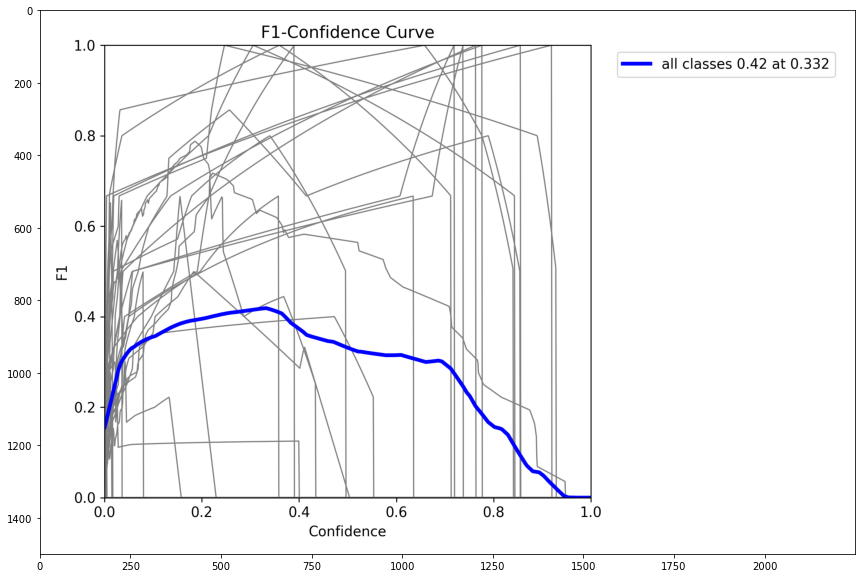

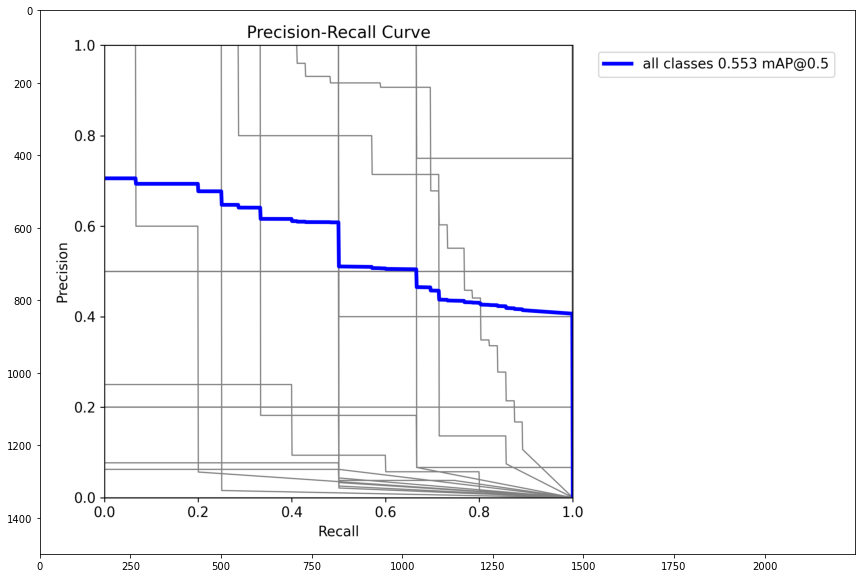

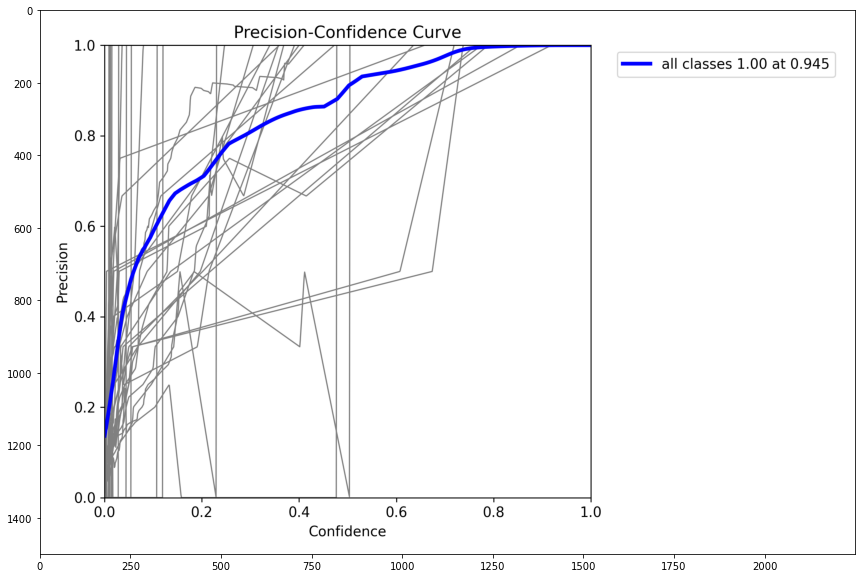

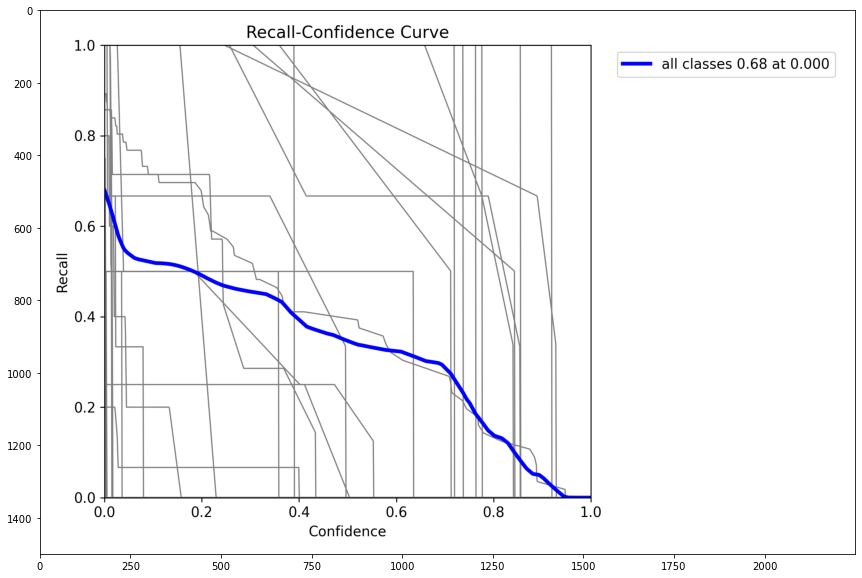

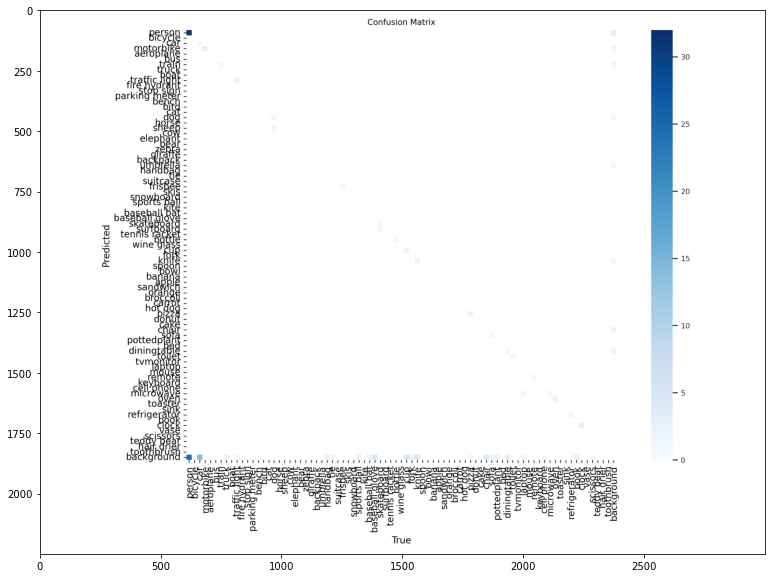

...

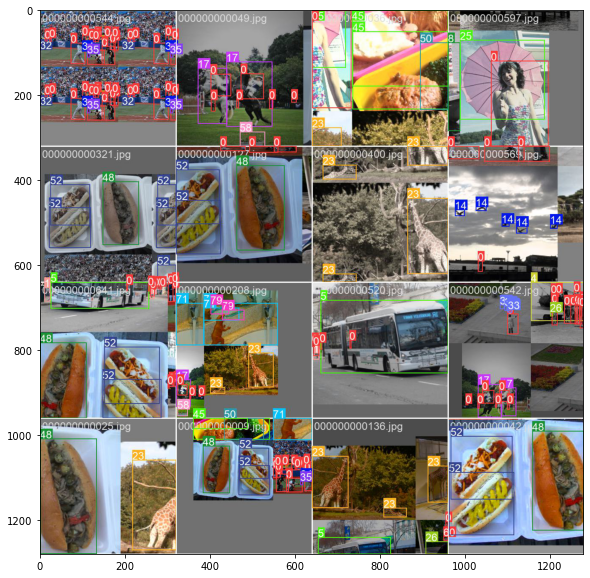

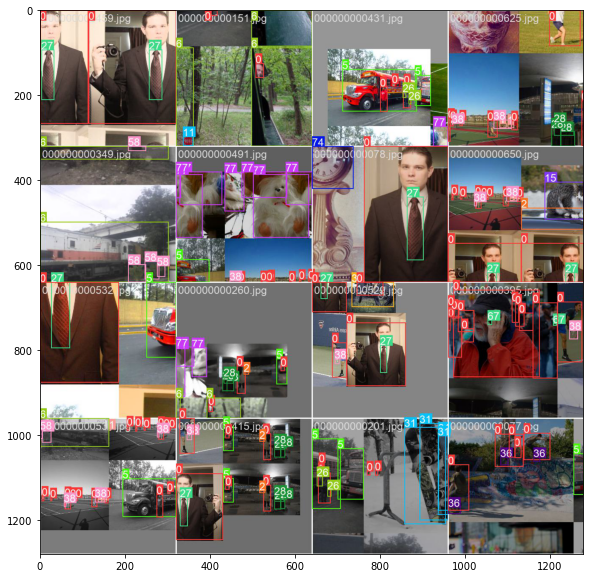

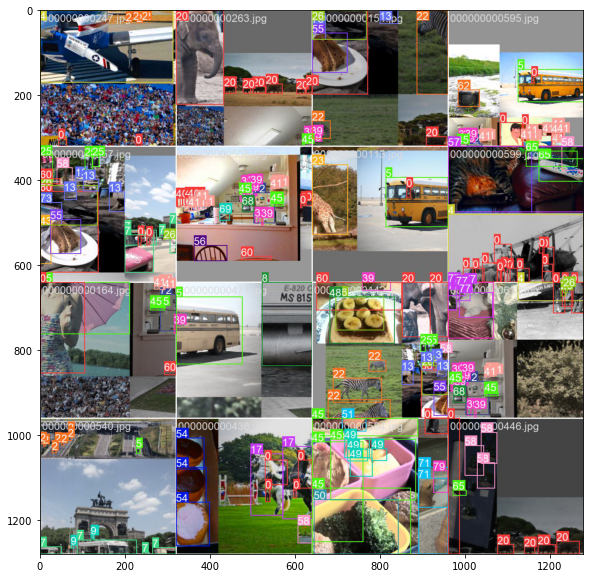

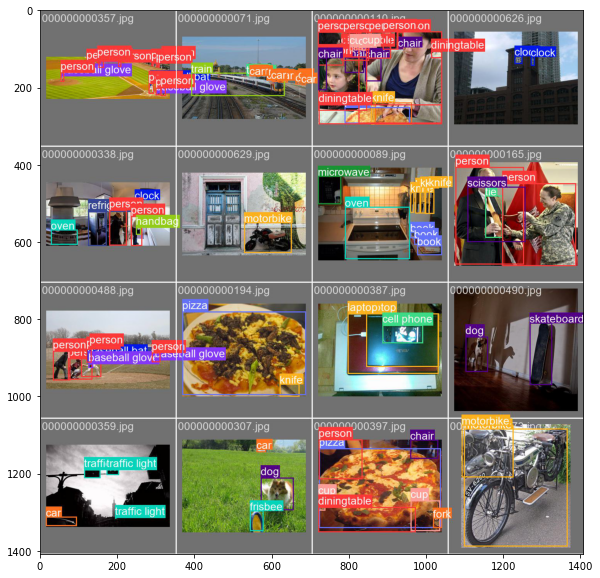

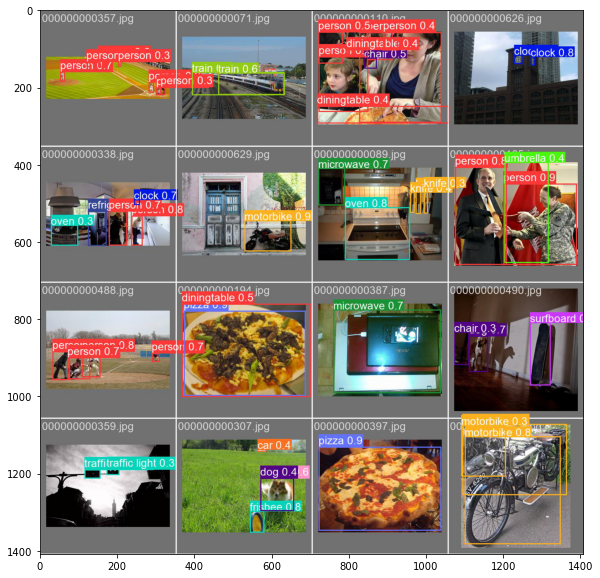

In [11]:
for path in tpaths2:
    image = Image.open(path)
    image=np.array(image)
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()

# Predict

In [12]:
print('Predict')
best_path0='runs/detect/train/weights/best.pt'
source0='datasets/test'

Predict


In [13]:
ppaths=[]
for dirname, _, filenames in os.walk(source0):
    for filename in filenames:
        if filename[-4:]=='.jpg':
            ppaths+=[(os.path.join(dirname, filename))]
ppaths=sorted(ppaths)
print(ppaths[0])

datasets/test/000000000034.jpg


In [14]:
model2 = YOLO(best_path0)
print('yolo task=detect mode=predict')

yolo task=detect mode=predict


In [15]:
!yolo task=detect mode=predict model={best_path0} conf=0.4 source={source0}

Ultralytics YOLOv8.0.115 🚀 Python-3.7.12 torch-1.11.0 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)
Model summary (fused): 168 layers, 3151904 parameters, 0 gradients

image 1/28 /kaggle/working/datasets/test/000000000034.jpg: 224x320 1 zebra, 18.7ms
image 2/28 /kaggle/working/datasets/test/000000000061.jpg: 256x320 (no detections), 12.1ms
image 3/28 /kaggle/working/datasets/test/000000000072.jpg: 320x224 2 giraffes, 11.2ms
image 4/28 /kaggle/working/datasets/test/000000000074.jpg: 224x320 2 persons, 1 bicycle, 1 dog, 7.6ms
image 5/28 /kaggle/working/datasets/test/000000000092.jpg: 224x320 1 fork, 1 cake, 6.8ms
image 6/28 /kaggle/working/datasets/test/000000000094.jpg: 224x320 1 car, 1 bus, 8.8ms
image 7/28 /kaggle/working/datasets/test/000000000109.jpg: 224x320 (no detections), 6.8ms
image 8/28 /kaggle/working/datasets/test/000000000138.jpg: 288x320 1 oven, 1 refrigerator, 1 clock, 11.0ms
image 9/28 /kaggle/working/datasets/test/000000000143.jpg: 288x320 4 birds, 7.2ms
image 10/28 /kaggle/w

# Result of Prediction

In [16]:
print('Result of Prediction')
results = model2.predict(source0,conf=0.4)
print(len(results))

Result of Prediction



image 1/28 /kaggle/working/datasets/test/000000000034.jpg: 224x320 1 zebra, 18.2ms
image 2/28 /kaggle/working/datasets/test/000000000061.jpg: 256x320 (no detections), 12.3ms
image 3/28 /kaggle/working/datasets/test/000000000072.jpg: 320x224 2 giraffes, 11.8ms
image 4/28 /kaggle/working/datasets/test/000000000074.jpg: 224x320 2 persons, 1 bicycle, 1 dog, 7.8ms
image 5/28 /kaggle/working/datasets/test/000000000092.jpg: 224x320 1 fork, 1 cake, 7.2ms
image 6/28 /kaggle/working/datasets/test/000000000094.jpg: 224x320 1 car, 1 bus, 7.4ms
image 7/28 /kaggle/working/datasets/test/000000000109.jpg: 224x320 (no detections), 6.8ms
image 8/28 /kaggle/working/datasets/test/000000000138.jpg: 288x320 1 oven, 1 refrigerator, 1 clock, 11.6ms
image 9/28 /kaggle/working/datasets/test/000000000143.jpg: 288x320 4 birds, 7.0ms
image 10/28 /kaggle/working/datasets/test/000000000149.jpg: 224x320 (no detections), 7.5ms
image 11/28 /kaggle/working/datasets/test/000000000196.jpg: 256x320 6 bowls, 1 pizza, 1 din

28


In [17]:
PBOX=pd.DataFrame(columns=range(6))
for i in range(len(results)):
    arri=pd.DataFrame(results[i].boxes.data).astype(float)
    path=ppaths[i]
    file=path.split('/')[-1]
    arri=arri.assign(file=file)
    arri=arri.assign(i=i)
    PBOX=pd.concat([PBOX,arri],axis=0)
PBOX.columns=['x','y','x2','y2','confidence','class','file','i']
display(PBOX)

,x,y,x2,y2,confidence,class,file,i
0,0.665710,22.160950,438.106689,399.689178,0.924523,22.0,000000000034.jpg,0.0
0,47.055168,70.586853,282.683838,640.000000,0.883716,23.0,000000000072.jpg,2.0
1,143.482025,82.016052,427.000000,640.000000,0.796359,23.0,000000000072.jpg,2.0
0,62.642212,275.866272,359.290039,379.547546,0.826141,16.0,000000000074.jpg,3.0
1,0.274261,40.142914,164.342590,327.946198,0.792302,1.0,000000000074.jpg,3.0
2,297.867737,93.178886,317.724670,154.957214,0.481046,0.0,000000000074.jpg,3.0
3,272.236938,85.695984,293.857300,146.781830,0.454114,0.0,000000000074.jpg,3.0
0,134.894653,1.223511,489.641418,296.593933,0.942879,55.0,000000000092.jpg,4.0
1,420.215576,116.515930,586.473999,427.000000,0.932280,42.0,000000000092.jpg,4.0
0,356.184021,278.373352,396.836975,314.616150,0.642581,2.0,000000000094.jpg,5.0


In [18]:
PBOX['class']=PBOX['class'].apply(lambda x: class_map[int(x)])
PBOX=PBOX.reset_index(drop=True)
display(PBOX)
display(PBOX['class'].value_counts())

,x,y,x2,y2,confidence,class,file,i
0,0.665710,22.160950,438.106689,399.689178,0.924523,zebra,000000000034.jpg,0.0
1,47.055168,70.586853,282.683838,640.000000,0.883716,giraffe,000000000072.jpg,2.0
2,143.482025,82.016052,427.000000,640.000000,0.796359,giraffe,000000000072.jpg,2.0
3,62.642212,275.866272,359.290039,379.547546,0.826141,dog,000000000074.jpg,3.0
4,0.274261,40.142914,164.342590,327.946198,0.792302,bicycle,000000000074.jpg,3.0
5,297.867737,93.178886,317.724670,154.957214,0.481046,person,000000000074.jpg,3.0
6,272.236938,85.695984,293.857300,146.781830,0.454114,person,000000000074.jpg,3.0
7,134.894653,1.223511,489.641418,296.593933,0.942879,cake,000000000092.jpg,4.0
8,420.215576,116.515930,586.473999,427.000000,0.932280,fork,000000000092.jpg,4.0
9,356.184021,278.373352,396.836975,314.616150,0.642581,car,000000000094.jpg,5.0


person           13
bowl              7
bird              4
cat               2
pizza             2
giraffe           2
umbrella          2
clock             2
zebra             1
tie               1
remote            1
aeroplane         1
bench             1
pottedplant       1
sink              1
tvmonitor         1
tennis racket     1
diningtable       1
microwave         1
oven              1
refrigerator      1
bus               1
car               1
fork              1
cake              1
bicycle           1
dog               1
bottle            1
Name: class, dtype: int64

In [19]:
def draw_box2(n0):
    
    ipath=ppaths[n0]
    image=cv2.imread(ipath)
    H,W=image.shape[0],image.shape[1]
    file=ipath.split('/')[-1]
    
    if PBOX[PBOX['file']==file] is not None:
        box=PBOX[PBOX['file']==file]
        box=box.reset_index(drop=True)
        #display(box)

        for i in range(len(box)):
            label=box.loc[i,'class']
            x=int(box.loc[i,'x'])
            y=int(box.loc[i,'y'])
            x2=int(box.loc[i,'x2']) 
            y2=int(box.loc[i,'y2'])
            #print(label,x,y,x2,y2)
            cv2.putText(image, f'{label}', (x, int(y-4)), 
                        cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0,255,0),2)
            cv2.rectangle(image,(x,y),(x2,y2),(0,255,0),2) #green
    
    #plt.imshow(image)
    #plt.show()   
    
    return image

In [20]:
def create_animation(ims):
    fig=plt.figure(figsize=(12,8))
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    text = plt.text(0.05, 0.05, f'Slide {0}', transform=fig.transFigure, fontsize=14, color='blue')
    plt.axis('off')
    plt.close()

    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        text.set_text(f'Slide {20+i}')        
        return [im]    
    
    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000)

In [21]:
images2=[]
for i in tqdm(range(len(ppaths))):
    images2+=[draw_box2(i)]

100%|██████████| 28/28 [00:00<00:00, 202.65it/s]


In [22]:
create_animation(images2)

for YOLOv8 custom training, login to wandb seemed to become essential.